In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab.patches import cv2_imshow
import zipfile
import tensorflow as tf
from tensorflow import keras
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Dropout, MaxPooling2D, Conv2D, Dense, Flatten, BatchNormalization

In [ ]:
from google.colab import drive
drive.mount("/content/drive") 

Mounted at /content/drive


In [ ]:
path = "/content/drive/MyDrive/Data science/Computer Vision Masterclass/Datasets/fer_images.zip"
zip_object = zipfile.ZipFile(file = path, mode = "r")
zip_object.extractall("./")
zip_object.close()

In [ ]:
train_generator = ImageDataGenerator(rescale = 1./255,
                                     rotation_range = 7,
                                     horizontal_flip = True,
                                     zoom_range = 0.2)
train = train_generator.flow_from_directory("/content/fer2013/train",
                                            target_size = (48, 48),
                                            batch_size = 16,
                                            class_mode = "categorical",
                                            shuffle = True)

Found 28709 images belonging to 7 classes.


In [ ]:
np.unique(train.classes, return_counts= True)

(array([0, 1, 2, 3, 4, 5, 6], dtype=int32),
 array([3995,  436, 4097, 7215, 4965, 4830, 3171]))

In [ ]:
train.class_indices

{'Angry': 0,
 'Disgust': 1,
 'Fear': 2,
 'Happy': 3,
 'Neutral': 4,
 'Sad': 5,
 'Surprise': 6}

In [ ]:
test_generator = ImageDataGenerator(rescale = 1./255)
test = test_generator.flow_from_directory("/content/fer2013/validation",
                                          target_size =  (48, 48),
                                          batch_size = 1,
                                          class_mode = "categorical",
                                          shuffle = False)

Found 3589 images belonging to 7 classes.


In [ ]:
num_detectors = 32
num_classes = 7
width, height = 48, 48
epochs = 100

network = Sequential()
network.add(Conv2D(num_detectors, (3, 3), activation="relu", padding = "same", input_shape = (width, height, 3)))
network.add(BatchNormalization())
network.add(Conv2D(num_detectors, (3, 3), activation="relu", padding = "same"))
network.add(BatchNormalization())
network.add(MaxPooling2D(2, 2))
network.add(Dropout(0.2))

network.add(Conv2D(num_detectors * 2, (3, 3), activation="relu", padding = "same"))
network.add(BatchNormalization())
network.add(Conv2D(num_detectors * 2, (3, 3), activation="relu", padding = "same"))
network.add(BatchNormalization())
network.add(MaxPooling2D(2, 2))
network.add(Dropout(0.2))

network.add(Conv2D(num_detectors * 4, (3, 3), activation="relu", padding = "same"))
network.add(BatchNormalization())
network.add(Conv2D(num_detectors * 4, (3, 3), activation="relu", padding = "same"))
network.add(BatchNormalization())
network.add(MaxPooling2D(2, 2))
network.add(Dropout(0.2))


network.add(Conv2D(num_detectors * 8, (3, 3), activation="relu", padding = "same"))
network.add(BatchNormalization())
network.add(Conv2D(num_detectors * 8, (3, 3), activation="relu", padding = "same"))
network.add(BatchNormalization())
network.add(MaxPooling2D(2, 2))
network.add(Dropout(0.2))

network.add(Flatten())

network.add(Dense(num_detectors * 2, activation = "relu"))
network.add(BatchNormalization())
network.add(Dropout(0.2))

network.add(Dense(num_detectors * 2, activation = "relu"))
network.add(BatchNormalization())
network.add(Dropout(0.2))

network.add(Dense(num_classes, activation="softmax"))

In [ ]:
network.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 48, 48, 32)        896       
_________________________________________________________________
batch_normalization (BatchNo (None, 48, 48, 32)        128       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 48, 48, 32)        9248      
_________________________________________________________________
batch_normalization_1 (Batch (None, 48, 48, 32)        128       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 24, 24, 32)        0         
_________________________________________________________________
dropout (Dropout)            (None, 24, 24, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 24, 24, 64)        1

In [ ]:
network.compile(optimizer="Adam", loss = "categorical_crossentropy", metrics = ["accuracy"])
network.fit(train, epochs = 100)

Epoch 1/100
1795/1795 [==============================] - 88s 22ms/step - loss: 2.0439 - accuracy: 0.2101
Epoch 2/100
1795/1795 [==============================] - 39s 22ms/step - loss: 1.6672 - accuracy: 0.3395
Epoch 3/100
1795/1795 [==============================] - 39s 22ms/step - loss: 1.4688 - accuracy: 0.4349
Epoch 4/100
1795/1795 [==============================] - 39s 22ms/step - loss: 1.3552 - accuracy: 0.4810
Epoch 5/100
1795/1795 [==============================] - 39s 22ms/step - loss: 1.2988 - accuracy: 0.5086
Epoch 6/100
1795/1795 [==============================] - 40s 22ms/step - loss: 1.2333 - accuracy: 0.5347
Epoch 7/100
1795/1795 [==============================] - 39s 22ms/step - loss: 1.2103 - accuracy: 0.5494
Epoch 8/100
1795/1795 [==============================] - 39s 22ms/step - loss: 1.1663 - accuracy: 0.5615
Epoch 9/100
1795/1795 [==============================] - 38s 21ms/step - loss: 1.1377 - accuracy: 0.5769
Epoch 10/100
1795/1795 [==============================]

In [ ]:
model_json = network.to_json()
with open("network_emotions.json", "w") as json_file:
  json_file.write(model_json)

In [ ]:
from keras.models import save_model
model_saved = save_model(network, "weights.hdf5")

In [ ]:
with open("network_emotions.json") as json_file:
  new_model = json_file.read()
new_model

'{"class_name": "Sequential", "config": {"name": "sequential", "layers": [{"class_name": "InputLayer", "config": {"batch_input_shape": [null, 48, 48, 3], "dtype": "float32", "sparse": false, "ragged": false, "name": "conv2d_input"}}, {"class_name": "Conv2D", "config": {"name": "conv2d", "trainable": true, "batch_input_shape": [null, 48, 48, 3], "dtype": "float32", "filters": 32, "kernel_size": [3, 3], "strides": [1, 1], "padding": "same", "data_format": "channels_last", "dilation_rate": [1, 1], "groups": 1, "activation": "relu", "use_bias": true, "kernel_initializer": {"class_name": "GlorotUniform", "config": {"seed": null}}, "bias_initializer": {"class_name": "Zeros", "config": {}}, "kernel_regularizer": null, "bias_regularizer": null, "activity_regularizer": null, "kernel_constraint": null, "bias_constraint": null}}, {"class_name": "BatchNormalization", "config": {"name": "batch_normalization", "trainable": true, "dtype": "float32", "axis": [3], "momentum": 0.99, "epsilon": 0.001, "c

In [ ]:
laoded_model = keras.models.model_from_json(new_model)
laoded_model.load_weights("/content/weights.hdf5")
laoded_model.compile(loss = "binary_crossentropy", optimizer = "Adam", metrics = ["accuracy"])

In [ ]:
laoded_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 48, 48, 32)        896       
_________________________________________________________________
batch_normalization (BatchNo (None, 48, 48, 32)        128       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 48, 48, 32)        9248      
_________________________________________________________________
batch_normalization_1 (Batch (None, 48, 48, 32)        128       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 24, 24, 32)        0         
_________________________________________________________________
dropout (Dropout)            (None, 24, 24, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 24, 24, 64)        1

In [ ]:
laoded_model.evaluate(test)

3589/3589 [==============================] - 13s 3ms/step - loss: 0.5759 - accuracy: 0.5784


[0.57585608959198, 0.5784341096878052]

In [ ]:
image = cv2.imread("/content/drive/MyDrive/Data science/Computer Vision Masterclass/Images/gabriel.png")

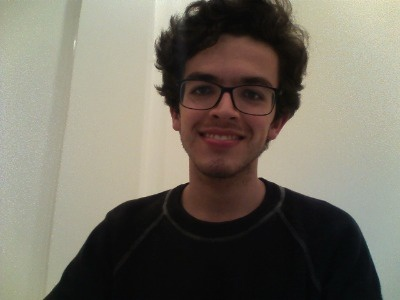

In [ ]:
cv2_imshow(image)

In [ ]:
face_detector = cv2.CascadeClassifier("/content/drive/MyDrive/Data science/Computer Vision Masterclass/Cascades/haarcascade_frontalface_default.xml")
original_image = image.copy()
face = face_detector.detectMultiScale(original_image)

In [ ]:
face

array([[162,  40, 128, 128]], dtype=int32)

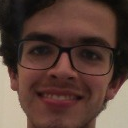

In [ ]:
roi = image[40:40 + 128, 162:162 + 128]
cv2_imshow(roi)

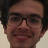

In [ ]:
roi = cv2.resize(roi, (48, 48))
cv2_imshow(roi)

In [ ]:
roi = roi / 255

In [ ]:
roi = np.expand_dims(roi, axis = 0)
roi.shape

(1, 48, 48, 3)

In [ ]:
prob = laoded_model.predict_classes(roi)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:455: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


In [ ]:
prob

array([3])

In [ ]:
# another way of predicting:
prob = laoded_model.predict(roi)
result = np.argmax(prob)
prob

array([[1.6108040e-04, 3.1844755e-07, 2.9239635e-04, 9.7465229e-01,
        2.4207832e-02, 6.8599777e-04, 6.4263355e-09]], dtype=float32)

In [ ]:
result

3

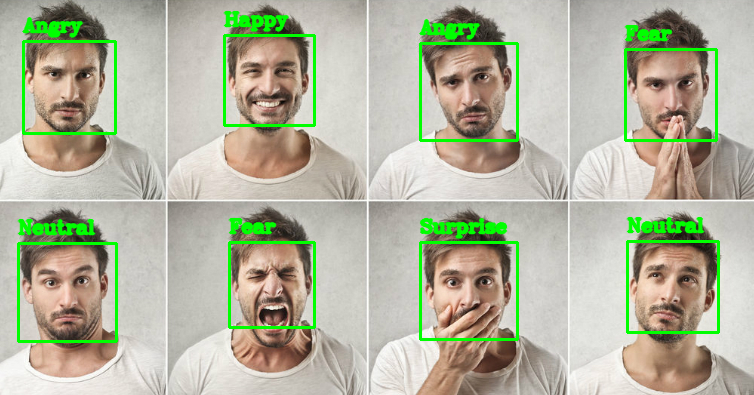

In [ ]:
#for detecting multiple faces
image = cv2.imread("/content/drive/MyDrive/Data science/Computer Vision Masterclass/Images/faces_emotions.png")
emotions = ['Angry', 'Disgust', 'Fear', 'Happy', 'Neutral', 'Sad', 'Surprise']
face_detector = cv2.CascadeClassifier("/content/drive/MyDrive/Data science/Computer Vision Masterclass/Cascades/haarcascade_frontalface_default.xml")
faces = face_detector.detectMultiScale(image)
for detection in faces:
  x, y, w, h = detection
  roi = image[y: y+h, x: x+w]
  roi = cv2.resize(roi, (48, 48))
  roi = np.expand_dims(roi, axis = 0)
  roi = roi/255
  probs = laoded_model.predict(roi)
  pred = np.argmax(probs)
  cv2.rectangle(image, (x, y), (x +w, y + h), (0, 255, 0), 2)
  cv2.putText(image, emotions[pred], (x, y-10), cv2.FONT_HERSHEY_COMPLEX, 0.6, (0, 255, 0), 2, cv2.LINE_AA)
cv2_imshow(image) 

## Classifying Emotions In Videos

In [ ]:
cap = cv2.VideoCapture("/content/drive/MyDrive/Data science/Computer Vision Masterclass/Videos/emotion_test01.mp4")
connected, video = cap.read()
print(connected, video.shape)

True (360, 640, 3)


In [ ]:
save_path = "/content/drive/MyDrive/Data science/Computer Vision Masterclass/Videos/emotion_test01_result.mp4"
fourcc = cv2.VideoWriter_fourcc(*"XVID")
fps = 24
output_video = cv2.VideoWriter(save_path, fourcc, fps, (video.shape[1], video.shape[0]))

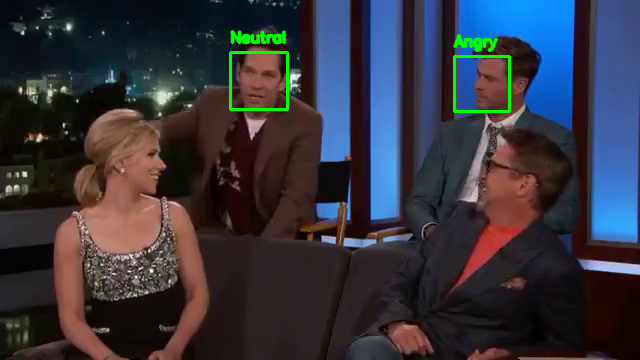

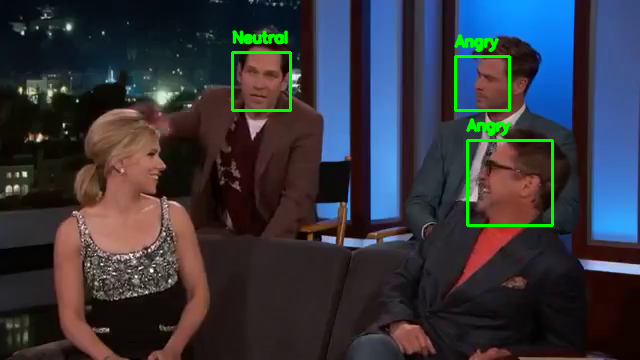

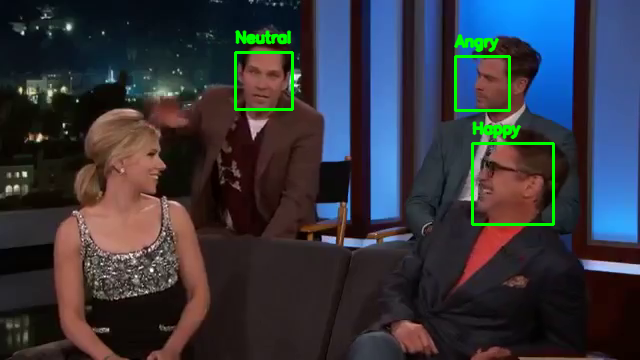

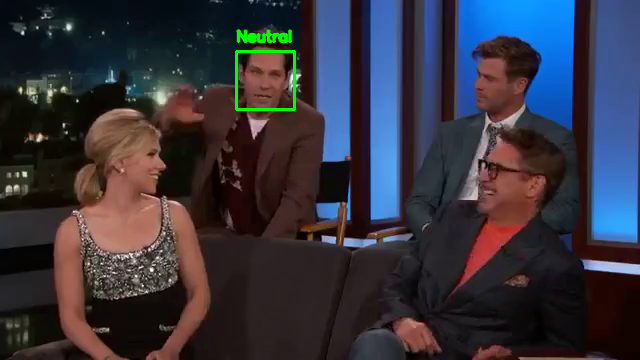

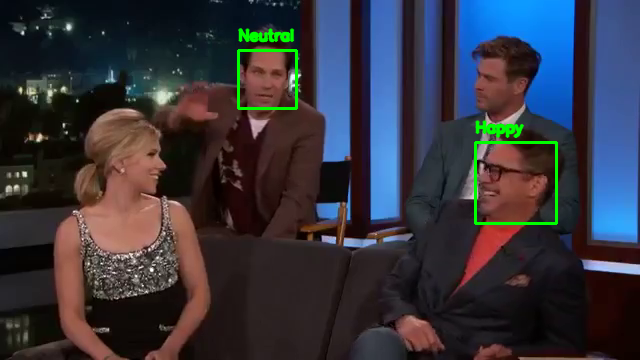

...

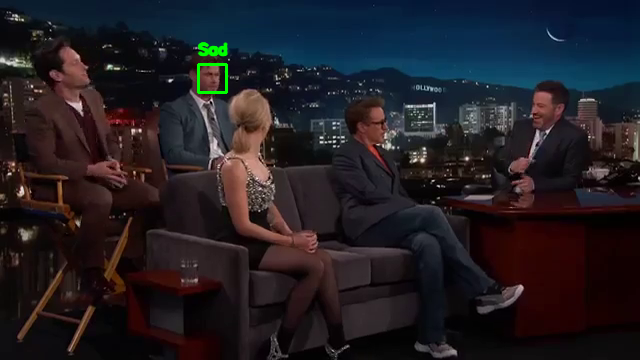

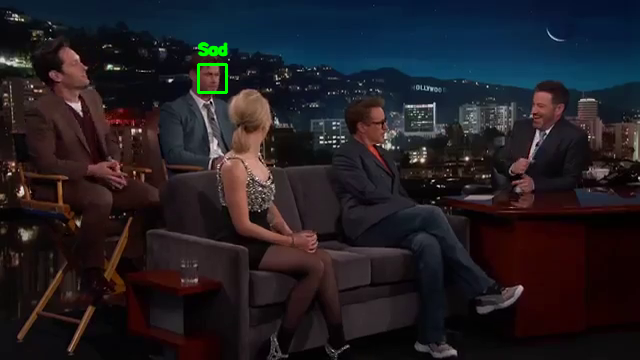

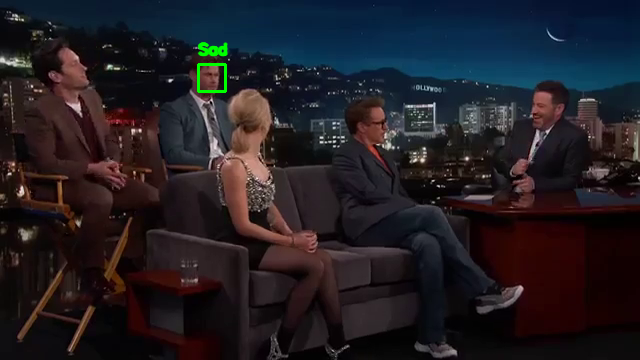

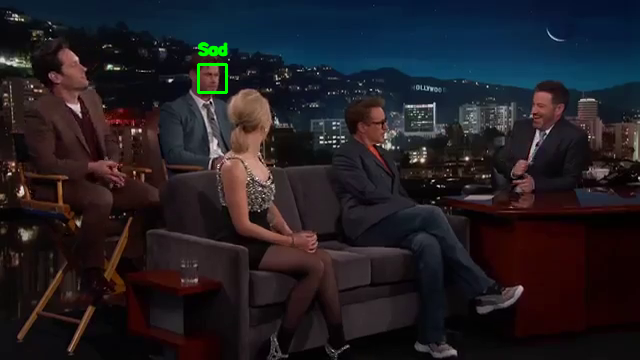

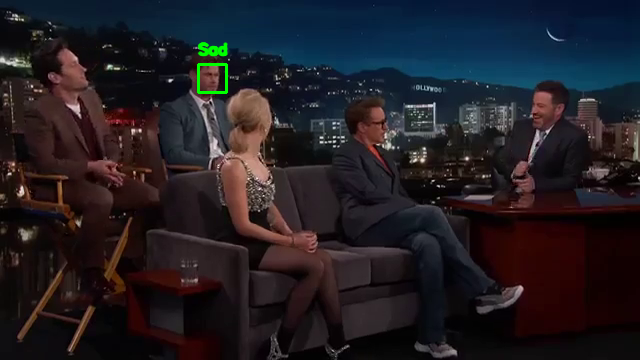

END


In [ ]:
emotions = ['Angry', 'Disgust', 'Fear', 'Happy', 'Neutral', 'Sad', 'Surprise']
while(cv2.waitKey(1) < 0):
  connected, frame = cap.read()
  if not connected:
    break
  else:
    face_detector = cv2.CascadeClassifier("/content/drive/MyDrive/Data science/Computer Vision Masterclass/Cascades/haarcascade_frontalface_default.xml")
    faces = face_detector.detectMultiScale(frame)
    if(len(faces) > 0):
      for detection in faces:
        x, y, w, h = detection
        roi = frame[y: y + h, x: x + w]
        roi = cv2.resize(roi, (48, 48))
        roi = np.expand_dims(roi, axis = 0)
        roi = roi/255
        pred = np.argmax(laoded_model.predict(roi))
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0, 255, 0), 2)
        cv2.putText(frame, emotions[pred], (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2, cv2.LINE_AA)
    cv2_imshow(frame)

    output_video.write(frame)
print("END")
output_video.release()
cv2.destroyAllWindows()